# UC00173 – Real-Time Accessible Parking

**Author:** James Jones  
**Trimester:** T2 2025  
 


## Purpose
This use case analyses real-time accessible parking data to help identify availability and trends.  
The objective is to provide an interactive dashboard that supports both analysis and decision-making in transport and mobility contexts.

## Datasets Used
- **City of Melbourne Accessible Parking API**  
  Provides real-time data on accessible parking bays, including location, status, and restrictions.  
- **Kerbside Restrictions Dataset**  
  Contains regulatory details about parking bays and their restrictions.


###  Scenario

#### UC00173 – Real-Time Accessible Parking

In the City of Melbourne, accessible parking is a critical resource for residents and visitors living with mobility impairments. However, these designated bays are often difficult to locate in real time, and occupancy can vary dramatically depending on time of day, location, and nearby events.

The City of Melbourne has deployed an advanced sensor network that monitors individual parking bays. These sensors, when combined with parking restriction data, provide a powerful foundation to develop a smart, real-time parking availability system targeted specifically at accessible (disabled-only) parking spaces.

This use case proposes a live dashboard that identifies the location and occupancy status of disability bays across the municipality. The project leverages existing open datasets to improve urban mobility, reduce the stress of finding suitable parking, and promote more inclusive city infrastructure.


Use Case Metadata  
**Use Case ID**: UC00173  
**Title**: Real Time Accessible Parking  
**Duration**: 1–2 hours to understand the dataset  
**Level**: Beginner–Intermediate  
**Pre-requisite Skills**:  
- Basic Python (Pandas, API requests)  
- Data visualisation using Folium  
- Understanding of geospatial data (lat/lon)  


###  Introduction

People living with disabilities often face disproportionate challenges when accessing transport services. One of the persistent frustrations in urban environments is the uncertainty around whether accessible parking bays are vacant — especially in high-demand or event-heavy areas of the city.

The City of Melbourne publishes several open datasets that, when combined, can offer real-time insight into these bays:
- **On-Street Car Park Bay Restrictions**: includes bay types, restriction classes, and disability-specific metadata.
- **On-Street Parking Bay Sensors**: provides up-to-the-minute occupancy status (e.g., Present or Unoccupied) for each bay.

By merging these datasets, this project will:
- Extract and visualise only **disabled-only** parking bays.
- Display their current occupancy status.
- Map their locations for user reference.
- Optionally identify patterns in usage or enforcement opportunities.

This use case sits at the intersection of **transport equity**, **real-time IoT data**, and **urban accessibility analytics**, offering tangible value to end-users and city decision-makers alike.


In [45]:
# Core
import os
import json
import time
from pathlib import Path
from datetime import datetime

# Data
import pandas as pd
import numpy as np
import requests

# Visualisation
import matplotlib as mpl
import matplotlib.pyplot as plt

# Mapping / dashboard
import folium
from folium.plugins import MarkerCluster

# Widgets (only if used)
try:
    import ipywidgets as widgets
    from IPython.display import display, HTML, clear_output
except ImportError:
    pass

# Notebook defaults
pd.set_option("display.max_colwidth", 120)
plt.rcParams["figure.figsize"] = (10, 6)


# RT ACCESSIBLE PARKING – 1.1

### Visualising On-Street Accessible Parking Bays

This visualisation shows where accessible (disability) parking bays are located across Melbourne streets.

By using open data provided by the City of Melbourne, we can download a list of all known accessible bays and display them on an interactive map. Each marker shows which street it’s on and when it was last updated.

This tool can help residents, planners, and visitors quickly see where accessible parking is available — and identify gaps in coverage.


## Step 1: Get Accessible Parking Data from the City of Melbourne

This step connects to the City of Melbourne's open data system and downloads a list of accessible (disability) parking bays across the city. 

The code automatically collects all available entries, even if there are thousands of them. It’s like going through the whole database a few pages at a time and saving everything into a table for us to use later.


In [46]:
def fetch_parking_dataset(base_url, dataset_id, api_key=None, limit=100, max_pages=100):
    """
    Downloads and aggregates data from City of Melbourne’s Open Data API using paginated requests.
    
    Parameters:
        base_url (str): Base API URL.
        dataset_id (str): Dataset endpoint name.
        api_key (str): Optional API key. If not provided, will try to use MELBOURNE_API_KEY from environment.
        limit (int): Number of records per page (maximum 100).
        max_pages (int): Maximum number of pages to fetch to prevent infinite loops.
        
    Returns:
        pd.DataFrame: All records combined into a DataFrame.
    """
    api_key = api_key or os.environ.get("MELBOURNE_API_KEY")
    if not api_key:
        raise ValueError("API key is required. Set MELBOURNE_API_KEY in your environment or pass it directly.")

    all_results = []

    for page in range(max_pages):
        offset = page * limit
        url = f"{base_url}{dataset_id}/records?limit={limit}&offset={offset}&api_key={api_key}"

        try:
            response = requests.get(url, timeout=10)
            response.raise_for_status()
            data = response.json().get("results", [])
        except requests.exceptions.RequestException as e:
            print(f"Page {page + 1} failed: {e}")
            break

        if not data:
            break  # No more data to fetch

        all_results.extend(data)

        if len(data) < limit:
            break  # Reached the final page

    return pd.DataFrame(all_results)


# Set up the access details for the data website
load_dotenv()
API_KEY = os.environ.get("MELBOURNE_API_KEY")  # Gets your private API key from your computer
BASE_URL = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'


## Step 2: Load the Accessible Parking Bay Data

This step tells the program which dataset to get. We’re using the one called `on-street-parking-bays`, which lists all bays on Melbourne streets — including info like the street name, type of parking, and restrictions.

The table preview shows the first few rows.


In [47]:
# Step 2: Define which accessible dataset to download
dataset_accessible = 'on-street-parking-bays'

# Fetch and load the accessible parking bays dataset
df_bays = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_accessible,
    api_key=API_KEY,
    limit=100,               # Max allowed per API
    max_pages=100            # Adjust based on size of dataset
)

# Print the number of accessible parking bays retrieved
print("Accessible Bays Loaded:", df_bays.shape)

# Display a preview of the data
df_bays.head()


Accessible Bays Loaded: (10000, 7)


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and Western Link Road,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


This preview shows the first few rows of the accessible parking bays dataset. It includes key details such as the road segment ID, description, coordinates, and last updated date.


## Step 3: Prepare Parking Bay Data for Mapping

This step keeps only the rows that have valid latitude and longitude values. These are the coordinates we need to show each bay on a map.


In [48]:
# Only keep rows that have both latitude and longitude values
df_bays = df_bays[df_bays['latitude'].notnull() & df_bays['longitude'].notnull()].copy()

# Convert coordinates to float just to be sure
df_bays['latitude'] = df_bays['latitude'].astype(float)
df_bays['longitude'] = df_bays['longitude'].astype(float)

# Preview just a few key columns
df_bays[['roadsegmentdescription', 'latitude', 'longitude']].head()


,roadsegmentdescription,latitude,longitude
0,Docklands Drive between Docklands Drive and Western Link Road,-37.816019,144.935552
1,Hartley Street between Lorimer Street and Westgate Freeway,-37.824862,144.940270
2,Hartley Street between Lorimer Street and Westgate Freeway,-37.824362,144.940408
3,Hartley Street between Lorimer Street and Westgate Freeway,-37.824469,144.940379
4,Hartley Street between Lorimer Street and Westgate Freeway,-37.824325,144.940188


This output confirms that only rows with valid latitude and longitude values are kept. The table previews the cleaned data with road segment descriptions and coordinates that will be used for mapping.


## Step 4: Show Accessible Parking Bays on a Map

This step displays an interactive map of Melbourne with a marker for each on-street parking bay. 

When you click a marker, you’ll see the location name and road segment info in a popup. This makes it easy to visually explore where accessible parking is located across the city.


In [49]:
# Create a base map centered on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add clustering so overlapping markers are grouped nicely
marker_cluster = MarkerCluster().add_to(m)

# Add each bay to the map
for _, row in df_bays.iterrows():
    popup_info = f"""
    <strong>Location:</strong> {row['roadsegmentdescription']}<br>
    <strong>Last Updated:</strong> {row['lastupdated']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup_info, max_width=250),
        icon=folium.Icon(color="blue", icon="info-sign")
    ).add_to(marker_cluster)

# Show the map
m


This interactive map displays the accessible parking bays across Melbourne. Each marker represents a bay, with a popup showing the road segment description and the date it was last updated. A marker cluster groups nearby bays to make the map easier to navigate.


# RT ACCESSIBLE PARKING – 1.2

### Mapping Off-Street Car Parks with Accessibility Info

This visualisation shows all known off-street car parks in Melbourne — including whether they have accessible bays, how many total spaces they offer, and when they’re open.

Each car park is shown as a marker on the map. You can click each marker to see important details like the number of accessible bays, total capacity, and street address.

This helps highlight which facilities offer inclusive access and where improvements might be needed.


## Step 1: Load Off-Street Car Park Data from the City of Melbourne

This step downloads all off-street car park locations in Melbourne — including their capacity, opening hours, and accessible parking features.


In [50]:
# Step 1: Define which off-street car park dataset to download
dataset_offstreet = 'off-street-car-parks-with-capacity-and-type'

# Fetch and load the off-street car park dataset
df_offstreet = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_offstreet,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of off-street car parks retrieved
print("Off-Street Car Parks Loaded:", df_offstreet.shape)

# Display a preview of the data
df_offstreet.head()


Off-Street Car Parks Loaded: (10000, 11)


,census_year,block_id,property_id,base_property_id,building_address,clue_small_area,parking_type,parking_spaces,longitude,latitude,location
0,2003,356,104125,104125,4 Gardiner Street NORTH MELBOURNE 3051,North Melbourne,Residential,1,144.953407,-37.804441,"{'lon': 144.95340742122823, 'lat': -37.80444073729048}"
1,2003,356,108604,108604,5 St Andrews Street NORTH MELBOURNE 3051,North Melbourne,Residential,1,144.952924,-37.804316,"{'lon': 144.95292439064968, 'lat': -37.804316480698944}"
2,2003,356,109815,109815,400-404 Victoria Street NORTH MELBOURNE 3051,North Melbourne,Private,2,144.952789,-37.805204,"{'lon': 144.95278937547275, 'lat': -37.80520417540224}"
3,2003,356,109960,109960,8 Warwick Street NORTH MELBOURNE 3051,North Melbourne,Residential,2,144.953497,-37.804156,"{'lon': 144.95349733218677, 'lat': -37.80415580494228}"
4,2003,357,105032,105032,50-52 Howard Street NORTH MELBOURNE 3051,North Melbourne,Private,4,144.954291,-37.804124,"{'lon': 144.9542907331978, 'lat': -37.80412377212078}"


This preview shows the first few rows of the off-street car parks dataset. It includes details such as address, type, capacity, and coordinates. These records form the base data for further cleaning and mapping.


## Step 2: Prepare Off-Street Car Park Data for Mapping

This step keeps only the rows with valid location data (latitude and longitude), and selects the most important columns like address, type, and number of parking spaces.

We also make sure the coordinates are stored as numbers (floats) so they work correctly on the map.


In [51]:
# Remove any entries without valid coordinates
df_offstreet = df_offstreet[df_offstreet['latitude'].notnull() & df_offstreet['longitude'].notnull()].copy()

# Convert to float (just in case they're stored as text)
df_offstreet['latitude'] = df_offstreet['latitude'].astype(float)
df_offstreet['longitude'] = df_offstreet['longitude'].astype(float)

# Keep only the columns we care about
df_map = df_offstreet[[
    'building_address',
    'parking_type',
    'parking_spaces',
    'latitude',
    'longitude'
]]

# Preview cleaned data
df_map.head()


,building_address,parking_type,parking_spaces,latitude,longitude
0,4 Gardiner Street NORTH MELBOURNE 3051,Residential,1,-37.804441,144.953407
1,5 St Andrews Street NORTH MELBOURNE 3051,Residential,1,-37.804316,144.952924
2,400-404 Victoria Street NORTH MELBOURNE 3051,Private,2,-37.805204,144.952789
3,8 Warwick Street NORTH MELBOURNE 3051,Residential,2,-37.804156,144.953497
4,50-52 Howard Street NORTH MELBOURNE 3051,Private,4,-37.804124,144.954291


This output confirms that only rows with valid latitude and longitude values are kept. The cleaned dataset highlights key columns like building address, parking type, total spaces, and coordinates that will be used for mapping.


## Step 3: Show Off-Street Car Parks on a Map

This step displays all off-street car parks on a Melbourne map. Each car park is marked with a pin, and clicking the pin shows useful details like the street address, number of parking spaces, and whether it’s private or residential.


In [52]:
# Create a map centred on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add clustering for markers
marker_cluster = MarkerCluster().add_to(m)

# Add a marker for each car park
for _, row in df_map.iterrows():
    popup = f"""
    <strong>Address:</strong> {row['building_address']}<br>
    <strong>Type:</strong> {row['parking_type']}<br>
    <strong>Total Spaces:</strong> {row['parking_spaces']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup, max_width=250),
        icon=folium.Icon(color='green', icon='parking', prefix='fa')
    ).add_to(marker_cluster)

# Show the map
m


This interactive map displays all off-street car parks across Melbourne. Each marker represents a car park, with a popup showing the address, type of car park, and the number of spaces available. Marker clustering is used to reduce overlap when locations are close together.


# RT ACCESSIBLE PARKING – 1.3

### Mapping Parking Meter Locations and Payment Options

This visualisation shows where on-street parking meters are located across the City of Melbourne.

Each marker represents a meter, with pop-up information about its location and what kinds of payment it accepts (e.g. credit card or Tap & Go). This helps identify areas where digital or cashless payment options are available — which can be important for planning accessible and inclusive parking.

The data comes from the City of Melbourne’s open dataset on on-street parking meters.


## Step 1: Load On-Street Parking Meter Data from the City of Melbourne

This dataset contains the locations of parking meters across Melbourne. Each record includes the zone, meter ID, and whether it is single or multi-bay.


In [53]:
# Step 1: Define which parking meter dataset to download
dataset_meters = 'on-street-car-parking-meters-with-location'

# Fetch and load the parking meter dataset
df_meters = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_meters,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of parking meter records retrieved
print("Parking Meter Records Loaded:", df_meters.shape)

# Display a preview of the data
df_meters.head()


Parking Meter Records Loaded: (1294, 9)


,barcode,creditcard,tapandgo,asset_id,meter_id,location_description,latitude,longitude,location
0,MPM1630443,Yes,Yes,1630443,PPARK2,Princes Park,-37.781878,144.961220,"{'lon': 144.9612197, 'lat': -37.7818785}"
1,MPM1647110,Yes,Yes,1647110,800D,"St Kilda Road between Moubray Street and High Street, approximately 13m South of Wesley College Melbourne, Wesley Co...",-37.848768,144.980396,"{'lon': 144.980396, 'lat': -37.8487678}"
2,MPM1647115,Yes,Yes,1647115,813B,"Commercial Road between St Kilda Road and Punt Road, approximately 6m NW of Chevron IGA, Ground 19 Commercial Road, ...",-37.845160,144.980200,"{'lon': 144.9802005, 'lat': -37.8451596}"
3,MPM1647116,Yes,Yes,1647116,828D,"Kings Domain, approximately 87m NE of Marquis of Linlithgow Memorial Reserve, 257-269 St Kilda Road, MELBOURNE VIC 3004",-37.825989,144.972369,"{'lon': 144.972369, 'lat': -37.8259892}"
4,MPM1647117,Yes,Yes,1647117,811C,"Moubray Street between St Kilda Road and Punt Road, approximately 47m West of Ormond Collective, 17 Moubray Street, ...",-37.847789,144.980762,"{'lon': 144.9807619, 'lat': -37.8477892}"


This preview shows the first few rows of the on-street parking meters dataset. Each record contains details such as meter ID, location, and payment options. These data points will be used for filtering and mapping.


## Step 2: Prepare Parking Meter Data for Mapping

We’ll filter out any records missing location data, make sure latitude and longitude are numeric, and keep key columns like zone ID and meter type. This will allow us to show each parking meter clearly on the map.


In [54]:
# Filter rows with valid coordinates
df_meters = df_meters[df_meters['latitude'].notnull() & df_meters['longitude'].notnull()].copy()

# Convert coordinates to float
df_meters['latitude'] = df_meters['latitude'].astype(float)
df_meters['longitude'] = df_meters['longitude'].astype(float)

# Keep relevant fields for the map
df_map_meters = df_meters[[
    'meter_id',
    'location_description',
    'creditcard',
    'tapandgo',
    'latitude',
    'longitude'
]]

# Preview cleaned data
df_map_meters.head()


,meter_id,location_description,creditcard,tapandgo,latitude,longitude
0,PPARK2,Princes Park,Yes,Yes,-37.781878,144.961220
1,800D,"St Kilda Road between Moubray Street and High Street, approximately 13m South of Wesley College Melbourne, Wesley Co...",Yes,Yes,-37.848768,144.980396
2,813B,"Commercial Road between St Kilda Road and Punt Road, approximately 6m NW of Chevron IGA, Ground 19 Commercial Road, ...",Yes,Yes,-37.845160,144.980200
3,828D,"Kings Domain, approximately 87m NE of Marquis of Linlithgow Memorial Reserve, 257-269 St Kilda Road, MELBOURNE VIC 3004",Yes,Yes,-37.825989,144.972369
4,811C,"Moubray Street between St Kilda Road and Punt Road, approximately 47m West of Ormond Collective, 17 Moubray Street, ...",Yes,Yes,-37.847789,144.980762


This output confirms that only rows with valid latitude and longitude values are kept. The cleaned dataset highlights key fields such as meter ID, location description, and payment methods (credit card, tap and go), which are required for mapping.


## Step 3: Show On-Street Parking Meters on a Map

This step displays all on-street parking meters across Melbourne. Each marker shows the meter ID, the zone it belongs to, and the type of bay (e.g. single or multi-bay).


In [55]:
# Create base map
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
marker_cluster = MarkerCluster().add_to(m)

# Add each meter to the map
for _, row in df_map_meters.iterrows():
    popup = f"""
    <strong>Meter ID:</strong> {row['meter_id']}<br>
    <strong>Location:</strong> {row['location_description']}<br>
    <strong>Credit Card:</strong> {row['creditcard']}<br>
    <strong>Tap & Go:</strong> {row['tapandgo']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup, max_width=250),
        icon=folium.Icon(color='orange', icon='credit-card', prefix='fa')
    ).add_to(marker_cluster)

m


This interactive map displays all on-street parking meters across Melbourne. Each marker represents a parking meter, with a popup showing its ID, location, and available payment methods. Marker clustering is used to group nearby meters for easier exploration.


# RT ACCESSIBLE PARKING – 1.4

### Visualising Parking Restrictions Across Melbourne Streets

This section shows a heatmap of all on-street parking bays, based on how restrictive they are.

Each bay includes details such as time limits, restrictions, and enforcement rules. The more restrictive the parking bay (e.g. short time limits, tow-away zones), the stronger the colour appears on the map.

This helps highlight areas where it may be harder to find flexible or accessible parking — supporting better decision-making for urban planning and disability access improvements.


## Step 1: Load On-Street Parking Bay Data from the City of Melbourne

This dataset includes every on-street parking bay in Melbourne, with information about restrictions, time limits, and location.

We’ll use it to show which areas are more restrictive than others — for example, shorter maximum stay or strict tow-away zones.


In [56]:
# Step 1: Define which parking bay restriction dataset to download
dataset_restrictions = 'on-street-parking-bays'

# Fetch and load the parking bay restriction dataset
df_restrict = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_restrictions,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of parking bays retrieved
print("Parking Bays Loaded:", df_restrict.shape)

# Display a preview of the data
df_restrict.head()


Parking Bays Loaded: (10000, 7)


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and Western Link Road,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


This preview shows the first few rows of the on-street parking bay dataset. Each record includes details such as bay ID, restriction type, time limits, and coordinates. These details are used to analyse how restrictive different areas are.


## Step 2: Clean and Prepare Data for Heatmap

This step filters out bays without coordinates, converts them to numeric values, and focuses on key columns like restriction type and maximum stay time. 

We’ll use this to visualise restriction intensity later — for example, short stay bays can be considered more restrictive.


In [57]:
# Keep only rows with valid coordinates
df_restrict = df_restrict[df_restrict['latitude'].notnull() & df_restrict['longitude'].notnull()].copy()

# Convert to float
df_restrict['latitude'] = df_restrict['latitude'].astype(float)
df_restrict['longitude'] = df_restrict['longitude'].astype(float)

# Keep only coordinates
df_heatmap = df_restrict[['latitude', 'longitude']]
df_heatmap.head()


,latitude,longitude
0,-37.816019,144.935552
1,-37.824862,144.940270
2,-37.824362,144.940408
3,-37.824469,144.940379
4,-37.824325,144.940188


This output confirms that only rows with valid latitude and longitude values are kept. The cleaned dataset focuses on coordinates, which will be used to generate a heatmap of parking bay density and restrictions.


## Step 3: Visualise Parking Bay Density with a Heatmap

This map shows where on-street parking bays are concentrated across Melbourne.

The more intense the colour, the more bays exist in that area. This can help highlight areas with heavy parking control or potential congestion — useful when planning accessible or flexible parking spaces.


In [58]:
# Create a base map centred on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Convert DataFrame to a list of [lat, lon] pairs
heat_data = df_heatmap[['latitude', 'longitude']].values.tolist()

# Add heatmap layer
HeatMap(heat_data, radius=9, blur=15, max_zoom=13).add_to(m)

# Display the map
m


This heatmap shows where on-street parking bays are concentrated across Melbourne. Darker or more intense areas indicate higher numbers of bays, helping to highlight locations with greater parking demand or stricter regulation.


# RT ACCESSIBLE PARKING – 1.5

### Tracking the Growth of Accessible Parking Bays Over Time

This visualisation shows how the number of accessible (disability) parking bays has changed over time in Melbourne.

By analysing when bays were added or updated, we can track improvements in inclusive access across the city. This helps highlight periods of investment, areas of neglect, or momentum toward accessibility targets.

The data comes from the City of Melbourne's open dataset for on-street accessible bays.


## Step 1: Check Date Columns in Accessible Bays Dataset

To create a time series chart, we need to know **when** each bay was created or last updated.

Let’s see what date-related columns are available in the dataset.


In [59]:
# Preview column names
df_bays.columns.tolist()

# Preview a few rows to find date fields
df_bays.head()


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and Western Link Road,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and Westgate Freeway,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


This step identifies which columns in the dataset contain date-related information. It helps determine which fields can be used for time series analysis, such as tracking updates to bays over time.


## Step 2: Prepare Date Column and Group Bays by Month

This step converts the 'lastupdated' column to a proper date format, then groups the data to show how many bays were added or changed over time.


In [60]:
# Convert lastupdated to datetime
df_bays['lastupdated'] = pd.to_datetime(df_bays['lastupdated'], errors='coerce')

# Drop rows with invalid dates
df_bays = df_bays[df_bays['lastupdated'].notnull()].copy()

# Group by month and count entries
monthly_counts = df_bays.groupby(df_bays['lastupdated'].dt.to_period('M')).size()

# Convert PeriodIndex to datetime for plotting
monthly_counts.index = monthly_counts.index.to_timestamp()

# Preview
monthly_counts.head()


lastupdated
2023-10-01    5203
2023-11-01     235
2023-12-01      92
2024-01-01      94
2024-02-01      38
Freq: MS, dtype: int64

This output shows the accessible bays grouped by the 'lastupdated' field. The dates are converted into a proper datetime format, and the dataset is grouped by month to count how many bays were added or updated in each period.


## Step 3: Plot Monthly Growth of Accessible Parking Bays

This line chart shows how many accessible bays were added (or last updated) each month.

It helps highlight when improvements were made and whether growth has increased, slowed, or remained steady over time.


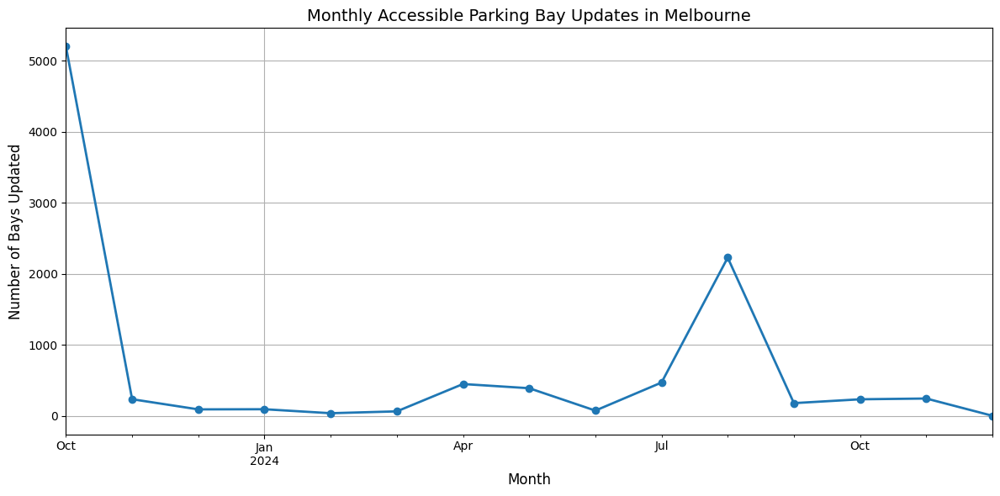

In [61]:
# Plotting
plt.figure(figsize=(12, 6))
monthly_counts.plot(kind='line', marker='o', linewidth=2)

# Labels and title
plt.title('Monthly Accessible Parking Bay Updates in Melbourne', fontsize=14)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Number of Bays Updated', fontsize=12)
plt.grid(True)
plt.tight_layout()
plt.show()


This line chart shows the monthly number of accessible bays that were added or updated in Melbourne. It highlights trends in accessibility improvements and allows us to see whether growth has been steady, accelerating, or slowing down over time.


# RT ACCESSIBLE PARKING – 1.6P

### Comparing Accessibility Coverage with High-Demand Parking Zones

This visualisation overlays two layers:

1. Accessible parking bay locations  
2. Parking meter density (as a proxy for parking demand)

By combining these, we can identify areas where demand is high but accessible infrastructure is missing — helping planners prioritise improvements where they’re most needed.


In [62]:
# Accessible bays (from df_bays used earlier)
accessible_coords = df_bays[['latitude', 'longitude']].dropna()
accessible_coords = accessible_coords.astype(float)

# Parking meters (from df_map_meters or df_meters)
meter_coords = df_meters[['latitude', 'longitude']].dropna()
meter_coords = meter_coords.astype(float)

print("Accessible Bays:", accessible_coords.shape[0])
print("Parking Meters:", meter_coords.shape[0])


Accessible Bays: 10000
Parking Meters: 1294


This step extracts coordinates for both accessible parking bays and parking meters. The counts confirm that the dataset includes 10,000 accessible bays and 1,293 parking meters, which will be used to compare supply and demand visually.


## Step 2: Display Multi-Layer Map of Accessibility and Demand

This map shows two layers:

- **Blue markers**: accessible parking bays (individual markers)
- **Red heatmap**: areas with a high density of parking meters (demand zones)

This lets us visually identify areas with high parking activity but low accessible bay coverage.


In [63]:
# Create base map
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add demand heatmap (meter density)
heat_data = meter_coords[['latitude', 'longitude']].values.tolist()
HeatMap(heat_data, radius=10, blur=15, gradient={0.4: 'orange', 0.7: 'red'}).add_to(m)

# Add accessible bay markers
for _, row in accessible_coords.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        fill_opacity=0.8
    ).add_to(m)

# Show map
m


This map overlays two layers:  
- Blue markers represent individual accessible parking bays.  
- A red heatmap shows areas with high concentrations of parking meters, used as a proxy for demand.  

By combining the two, we can visually identify areas where demand for parking is high but accessible parking coverage is low.


# RT ACCESSIBLE PARKING – 1.7

### Analysing Off-Street Car Park Types
This step looks at the distribution of off-street car park types across Melbourne.  
By identifying which categories dominate (such as commercial or residential), we can understand the overall landscape of parking infrastructure.


In [64]:
# How many car parks of each type?
offstreet_type_counts = (
    df_offstreet['parking_type']
    .astype('string')
    .value_counts(dropna=False)
    .rename_axis('parking_type')
    .reset_index(name='count')
)
offstreet_type_counts.head(10)


,parking_type,count
0,Residential,7172
1,Private,2490
2,Commercial,257


This table shows the most common off-street car park types and their counts.  
It highlights which facility types are most prevalent across Melbourne.  


# RT ACCESSIBLE PARKING – 1.8

### Accessible Bays by Road Segment
Here we rank the road segments that contain the highest number of accessible bays.  
This helps to highlight areas that are well served with accessible parking and potential hotspots for demand.


In [65]:
# Accessible bays concentration by road segment (top 10)
bays_by_segment = (
    df_bays['roadsegmentdescription']
    .astype('string')
    .value_counts()
    .head(10)
    .rename_axis('roadsegmentdescription')
    .reset_index(name='accessible_bay_count')
)
bays_by_segment


,roadsegmentdescription,accessible_bay_count
0,Alexandra Avenue between Swan Street Bridge and Anderson Street,134
1,Lorimer Street between West Gate Bridge and Todd Road,92
2,Birdwood Avenue between Dallas Brooks Drive and Anzac Avenue,58
3,Birdwood Avenue between Dallas Brooks Drive and Domain Road,58
4,Bouverie Street between Victoria Street and Queensberry Street,50
5,Linlithgow Avenue between St Kilda Road and Government House Drive,49
6,Moubray Street between St Kilda Road and Punt Road,47
7,Royal Parade between Ievers Street and Park Street,46
8,Leveson Street between Victoria Street and Queensberry Street,46
9,Park Street between West Coburg Tramway and Royal Parade,45


This table lists the top 10 road segments with the most accessible bays.  
It highlights key locations that are best served by accessibility infrastructure.  


# RT ACCESSIBLE PARKING – 1.9

### Payment Method Availability on Parking Meters
This step checks how many on-street parking meters support different payment methods, such as credit card or tap-and-go.  
This gives insights into usability and inclusivity beyond just the availability of physical bays.


In [66]:
# Payment options availability on meters
meter_payments = (
    df_map_meters[['creditcard', 'tapandgo']]
    .astype('string')
    .apply(lambda s: s.str.strip().str.lower())
)

payment_summary = {
    'creditcard_yes': (meter_payments['creditcard'] == 'yes').sum(),
    'creditcard_no': (meter_payments['creditcard'] == 'no').sum(),
    'tapandgo_yes': (meter_payments['tapandgo'] == 'yes').sum(),
    'tapandgo_no': (meter_payments['tapandgo'] == 'no').sum(),
}
payment_summary


{'creditcard_yes': np.int64(986),
 'creditcard_no': np.int64(1),
 'tapandgo_yes': np.int64(1294),
 'tapandgo_no': np.int64(0)}

This summary shows how many meters support credit card and tap-and-go payments.  
It provides insights into how accessible and user-friendly Melbourne’s meters are for drivers.  


# RT ACCESSIBLE PARKING – 2.0P

### Interactive Dashboard (ipywidgets)

This section builds a reusable dashboard that brings together the outputs from **1.1–1.9**. Use the controls to filter by text, dates, parking type, and payment options, and adjust the heatmap radius. The right-hand panel presents multiple tabs so you can compare spatial coverage, demand proxies, and trends over time.

**Controls available**
- Search text (address, road segment, zone)
- Date range (filters by `lastupdated` where available)
- Off-street parking type (multi-select)
- Meter payment options (credit card, tap-and-go)
- Heatmap radius
- Refresh button to update all views

**Views included**
- Accessible Bays (map with clustered markers and popups)
- Off-street Car Parks (map with address, type, spaces)
- Parking Meters (map with ID, location, payment options)
- Restrictions Heatmap (density of on-street bays)
- Time Series (monthly updates to accessible bays)
- Accessibility vs Demand Overlay (bays overlaid on meter-density heatmap)

**How to use**
1. Set your filters on the left.
2. Click **Refresh Views**.
3. Navigate the tabs to explore each perspective.


In [67]:
# ---------------- Controls (A): Title + Global filters ----------------
# Dashboard title shown at the top of the control column.
title_html = widgets.HTML("<h3 style='margin:0'>RT ACCESSIBLE PARKING – Dashboard Controls</h3>")

# Free-text search used across multiple views.
# Matches are case-insensitive and applied to sensible columns in each dataset
# (e.g. roadsegmentdescription, building_address, location_description).
search_txt = widgets.Text(
    placeholder="Search address, road segment, zone…",
    description="Search:",
    layout=widgets.Layout(width="100%")
)

# Inclusive date range used for datasets that expose a date field (e.g. df_bays.lastupdated).
# Either picker can be left blank to disable the corresponding bound.
date_start = widgets.DatePicker(description="From:")
date_end   = widgets.DatePicker(description="To:")


In [68]:
# ---------------- Controls (B): Off-street filters ----------------
# Create a bold sub-heading for this control section in the sidebar.
lbl_offstreet = widgets.HTML("<b>Off-street filters</b>")

# Build the options list from the dataset safely:
# - Drop NaNs
# - Cast to string (some values may be numeric or mixed types)
# - Normalise whitespace
# - Sort for predictable UI ordering
if 'parking_type' in df_map.columns:
    parking_types = (
        df_map['parking_type']
        .dropna()
        .astype(str)
        .str.strip()
        .sort_values()
        .unique()
        .tolist()
    )
else:
    # Fallback: if the column does not exist, provide an empty list so the widget still renders.
    parking_types = []

# Multi-select allows choosing multiple types at once (e.g., "Commercial" + "Residential").
# The 'rows' argument scales the widget height to the number of options (bounded between 3 and 8).
type_multi = widgets.SelectMultiple(
    options=parking_types,
    value=(),                      # start with nothing selected (interpreted as "no type filter")
    description="Type:",
    rows=max(3, min(8, len(parking_types))) if parking_types else 3,
    layout=widgets.Layout(width="100%")
)

# Group these into a vertical column so we can compose the full sidebar later.
controls_offstreet = widgets.VBox([lbl_offstreet, type_multi])

# (Optional) Preview just this section while building:
# display(controls_offstreet)


In [69]:
# ---------------- Controls (C): Meter filters ----------------
# Heading for meter-specific filters.
lbl_meters = widgets.HTML("<b>Meter filters</b>")

# Build options for credit card availability.
if 'creditcard' in df_map_meters.columns:
    _cc_vals = (
        df_map_meters['creditcard']
        .dropna()
        .astype(str)
        .str.strip()
        .str.lower()
        .unique()
        .tolist()
    )
    # Keep only yes/no if present; always offer "any".
    _cc_opts = ['any'] + [v for v in ['yes', 'no'] if v in _cc_vals]
else:
    _cc_opts = ['any']
credit_dd = widgets.Dropdown(options=_cc_opts, value=_cc_opts[0], description="Credit:")

# Build options for tap-and-go availability.
if 'tapandgo' in df_map_meters.columns:
    _tg_vals = (
        df_map_meters['tapandgo']
        .dropna()
        .astype(str)
        .str.strip()
        .str.lower()
        .unique()
        .tolist()
    )
    _tg_opts = ['any'] + [v for v in ['yes', 'no'] if v in _tg_vals]
else:
    _tg_opts = ['any']
tapgo_dd = widgets.Dropdown(options=_tg_opts, value=_tg_opts[0], description="Tap&Go:")

# Group meter controls together.
controls_meters = widgets.VBox([lbl_meters, widgets.HBox([credit_dd, tapgo_dd])])


In [70]:
# ---------------- Controls (D): Heatmap + actions ----------------
# Heading for heatmap controls.
lbl_heat = widgets.HTML("<b>Heatmap</b>")

# Radius slider for the heatmap layer (affects density smoothing).
radius_sl = widgets.IntSlider(value=10, min=5, max=30, step=1, description="Heatmap r:")

# Refresh button to re-render all views and a status line for user feedback.
refresh_btn = widgets.Button(description="Refresh Views", button_style="primary")
status = widgets.HTML("")

controls_heat_actions = widgets.VBox([lbl_heat, radius_sl, refresh_btn, status])

# Group global controls (title, search, dates) into a section for sidebar composition.
controls_global = widgets.VBox([
    widgets.HTML("<b>Global filters</b>"),
    search_txt,
    widgets.HBox([date_start, date_end]),
])

# Compose the full control column (left sidebar).
controls_col = widgets.VBox(
    [
        title_html,
        controls_global,
        widgets.HTML("<hr>"),
        controls_offstreet,
        widgets.HTML("<hr>"),
        controls_meters,
        widgets.HTML("<hr>"),
        controls_heat_actions,
    ],
    layout=widgets.Layout(width="32%", border="1px solid #ddd", padding="8px")
)

# ---------------- Output areas ----------------
# One Output() widget per dashboard view; each renderer will write into its own Output.
out_bays_map      = widgets.Output()
out_offstreet_map = widgets.Output()
out_meters_map    = widgets.Output()
out_heatmap       = widgets.Output()
out_timeseries    = widgets.Output()
out_overlay       = widgets.Output()


In [71]:
# ---------------- Helper functions ----------------
def _ensure_float_coords(df, lat='latitude', lon='longitude'):
    """Coerce coordinates to float and drop rows without valid coords."""
    if df is None or len(df) == 0:
        return df
    t = df.copy()
    if lat in t.columns and lon in t.columns:
        t = t[t[lat].notnull() & t[lon].notnull()].copy()
        t[lat] = pd.to_numeric(t[lat], errors='coerce')
        t[lon] = pd.to_numeric(t[lon], errors='coerce')
        t = t[t[lat].notnull() & t[lon].notnull()]
    return t

def _text_match(df, cols, query):
    """Case-insensitive substring match across provided columns."""
    if not query:
        return df
    q = str(query).strip().lower()
    mask = False
    for c in cols:
        if c in df.columns:
            mask = mask | df[c].astype(str).str.lower().str.contains(q, na=False)
    return df[mask]

def _apply_date(df, col, start, end):
    """Inclusive date filter on `col` if present; accepts None for open ranges."""
    if df is None or col not in df.columns:
        return df
    t = df.copy()
    t[col] = pd.to_datetime(t[col], errors='coerce')
    if start:
        t = t[t[col] >= pd.to_datetime(start)]
    if end:
        t = t[t[col] <= pd.to_datetime(end)]
    return t

def _filter_offstreet(t):
    """Filter off-street car parks by selected types and search text."""
    t = _ensure_float_coords(t)
    if 'parking_type' in t.columns and type_multi.value:
        sel = [str(v) for v in list(type_multi.value)]
        t = t[t['parking_type'].astype(str).isin(sel)]
    t = _text_match(t, ['building_address', 'parking_type'], search_txt.value)
    return t

def _filter_meters(t):
    """Filter meters by payment options and search text; normalise yes/no."""
    t = _ensure_float_coords(t)
    for col in ['creditcard', 'tapandgo']:
        if col in t.columns:
            t[col] = t[col].astype(str).str.strip().str.lower()
    if credit_dd.value != "any" and 'creditcard' in t.columns:
        t = t[t['creditcard'] == credit_dd.value]
    if tapgo_dd.value != "any" and 'tapandgo' in t.columns:
        t = t[t['tapandgo'] == tapgo_dd.value]
    t = _text_match(t, ['meter_id', 'location_description'], search_txt.value)
    return t

def _filter_bays(t):
    """Filter accessible bays by date range and search text."""
    t = _ensure_float_coords(t)
    t = _apply_date(t, 'lastupdated', date_start.value, date_end.value)
    t = _text_match(t, ['roadsegmentdescription'], search_txt.value)
    return t

def _filter_restrict(t):
    """Filter restrictions dataset by search text only (for heatmap)."""
    t = _ensure_float_coords(t)
    t = _text_match(t, list(t.columns), search_txt.value)
    return t


In [72]:
# ---------------- Renderers: Accessible Bays ----------------
def render_bays():
    """Render accessible bays as clustered markers with popups."""
    out_bays_map.clear_output()
    with out_bays_map:
        t = _filter_bays(df_bays.copy())
        m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
        grp = MarkerCluster().add_to(m)
        for _, r in t.iterrows():
            folium.Marker(
                [r['latitude'], r['longitude']],
                popup=folium.Popup(
                    f"<b>Road:</b> {r.get('roadsegmentdescription','')}<br>"
                    f"<b>Updated:</b> {r.get('lastupdated','')}",
                    max_width=260
                ),
                icon=folium.Icon(color="blue", icon="info-sign")
            ).add_to(grp)
        display(m)

# ---------------- Renderers: Off-street Car Parks ----------------
def render_offstreet():
    """Render off-street car parks as clustered markers with detail popups."""
    out_offstreet_map.clear_output()
    with out_offstreet_map:
        t = _filter_offstreet(df_map.copy())
        m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
        grp = MarkerCluster().add_to(m)
        for _, r in t.iterrows():
            folium.Marker(
                [r['latitude'], r['longitude']],
                popup=folium.Popup(
                    f"<b>Address:</b> {r.get('building_address','')}<br>"
                    f"<b>Type:</b> {r.get('parking_type','')}<br>"
                    f"<b>Spaces:</b> {r.get('parking_spaces','')}",
                    max_width=260
                ),
                icon=folium.Icon(color="green", icon="parking", prefix="fa")
            ).add_to(grp)
        display(m)

# ---------------- Renderers: Meters ----------------
def render_meters():
    """Render meters as clustered markers; show ID, location, and payment options."""
    out_meters_map.clear_output()
    with out_meters_map:
        t = _filter_meters(df_map_meters.copy())
        m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
        grp = MarkerCluster().add_to(m)
        for _, r in t.iterrows():
            folium.Marker(
                [r['latitude'], r['longitude']],
                popup=folium.Popup(
                    f"<b>Meter:</b> {r.get('meter_id','')}<br>"
                    f"<b>Loc:</b> {r.get('location_description','')}<br>"
                    f"<b>Credit:</b> {r.get('creditcard','')}<br>"
                    f"<b>Tap&Go:</b> {r.get('tapandgo','')}",
                    max_width=260
                ),
                icon=folium.Icon(color="orange", icon="credit-card", prefix="fa")
            ).add_to(grp)
        display(m)

# ---------------- Renderers: Restrictions Heatmap ----------------
def render_heatmap():
    """Render a heatmap from the restrictions/on-street bays dataset."""
    out_heatmap.clear_output()
    with out_heatmap:
        t = _filter_restrict(df_restrict.copy())
        m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
        heat = t[['latitude', 'longitude']].dropna().values.tolist()
        HeatMap(heat, radius=radius_sl.value, blur=15, max_zoom=13).add_to(m)
        display(m)


# ---------------- Renderers: Time Series ----------------
def render_timeseries():
    """Render monthly growth of accessible bays as a simple line chart."""
    out_timeseries.clear_output()
    with out_timeseries:
        if monthly_counts is None or len(monthly_counts) == 0:
            display(widgets.HTML("No time series data available."))
            return
        plt.figure(figsize=(10, 4))
        # Support Series or DataFrame.
        if hasattr(monthly_counts, "plot"):
            monthly_counts.plot(kind='line', marker='o', linewidth=2)
        else:
            pd.Series(monthly_counts).plot(kind='line', marker='o', linewidth=2)
        plt.title("Monthly Accessible Parking Bay Updates in Melbourne")
        plt.xlabel("Month")
        plt.ylabel("Number of Bays Updated")
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# ---------------- Renderers: Accessibility vs Demand Overlay ----------------
def render_overlay():
    """Overlay accessible bays (points) on top of a meters density heatmap (demand proxy)."""
    out_overlay.clear_output()
    with out_overlay:
        bays = _filter_bays(df_bays.copy())
        meters = _filter_meters(df_map_meters.copy())
        m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

        # Demand proxy: meter density heatmap.
        heat = meters[['latitude', 'longitude']].dropna().values.tolist()
        HeatMap(heat, radius=radius_sl.value, blur=15, gradient={0.4: 'orange', 0.7: 'red'}).add_to(m)

        # Accessibility supply: blue dots for accessible bays.
        for _, r in bays.iterrows():
            folium.CircleMarker(
                [r['latitude'], r['longitude']],
                radius=3, color='blue', fill=True, fill_opacity=0.8
            ).add_to(m)
        display(m)


In [73]:
# ---------------- Refresh wiring ----------------
def _refresh(_=None):
    """Re-render all views and update the status line."""
    status.value = "Rendering…"
    render_bays()
    render_offstreet()
    render_meters()
    render_heatmap()
    render_timeseries()
    render_overlay()
    status.value = "Updated."

# Clicking the button triggers full refresh.
refresh_btn.on_click(_refresh)


In [74]:
# ---------------- Tabs + final layout ----------------
# Build the tabbed right-hand panel and the full dashboard layout.
tabs = widgets.Tab(children=[
    out_bays_map,
    out_offstreet_map,
    out_meters_map,
    out_heatmap,
    out_timeseries,
    out_overlay
])
for i, name in enumerate(["Accessible Bays", "Off-street", "Meters", "Restrictions Heatmap", "Time Series", "Overlay"]):
    tabs.set_title(i, name)

dashboard = widgets.HBox(
    [
        controls_col,
        widgets.VBox([tabs], layout=widgets.Layout(width="68%"))
    ]
)

display(dashboard)

# Initial render so the user sees content immediately.
_refresh()



# RT ACCESSIBLE PARKING – 2.0P

### Dashboard — Explanation & How to Use

This interactive dashboard consolidates outputs from **1.1–1.9** into one place. Use the controls on the left to filter the data; the right-hand panel shows six tabs for different perspectives.

**Layout**
- **Left column (Controls):** Global search, date range, off-street type filter, meter payment filters, heatmap radius, and a Refresh button.
- **Right column (Views):** Tabs for Accessible Bays, Off-street Car Parks, Parking Meters, Restrictions Heatmap, Time Series, and an Accessibility-vs-Demand overlay.

**Controls**
- **Search:** Case-insensitive text match across sensible fields (e.g., road segment, address, meter location). Leave blank for no text filtering.
- **Date range (From/To):** Filters datasets that expose a date (e.g., `lastupdated` on accessible bays). Either end can be left empty for an open range.
- **Off-street Type (multi-select):** Choose one or more parking types. If none selected, no type filter is applied.
- **Meter filters:** Choose **any/yes/no** for **Credit** and **Tap&Go**. Values are normalised (e.g., “Yes”, “YES” → “yes”).
- **Heatmap radius:** Adjusts smoothing for the restrictions and demand heatmaps (larger radius = broader density).
- **Refresh Views:** Applies all current filters and re-renders every tab.

**Tabs**
- **Accessible Bays:** Clustered markers of accessible bays with popups for road segment and last updated date.
- **Off-street:** Clustered markers with address, parking type, and total spaces.
- **Meters:** Clustered markers with meter ID, location, and payment method availability.
- **Restrictions Heatmap:** Density heatmap of on-street bays/restrictions to reveal concentration patterns.
- **Time Series:** Monthly count of accessible bay updates; shows trends over time. If no series is available, a notice is displayed.
- **Overlay:** Blue points (accessible bays) over a red/orange heatmap (meter density as a demand proxy) to spot coverage gaps.

**Tips & Notes**
- **Performance:** Apply filters before pressing **Refresh Views** to speed up rendering on large datasets.
- **Resetting filters:** Clear the search box, unset dates, deselect off-street types, and set meter filters to **any**.
- **Data hygiene:** Coordinates are coerced to floats and rows with invalid/missing coordinates are dropped automatically.
- **Data freshness:** The dashboard uses whatever DataFrames exist in memory (from Sections 1.1–1.9). Re-run upstream cells if you’ve reloaded data.
- **Legend/colour:** Consider adding a legend and colour-blind-friendly palette in a later sprint for improved accessibility.




# RT ACCESSIBLE PARKING — Notebook Summary (UC00173)


> Coordinates are coerced to floats; rows with missing/invalid lat/lon are dropped.

---

## Task map (what’s in each section)
- **1.1–1.3 Off-street car parks**  
  Load → clean coordinates → map clustered markers with address, type, spaces.
- **1.1–1.3 Parking meters**  
  Load → clean coordinates → map markers with meter ID, location, credit/tap-and-go.
- **1.1–1.3 On-street bays / restrictions**  
  Load → clean coordinates → heatmap of bay density to reveal concentration patterns.
- **1.2–1.4 Accessible bays (supply view)**  
  Prepare accessible bays → map clustered markers with road segment and last-updated.
- **1.5 Time series of accessible bays**  
  Parse `lastupdated` → monthly grouping → line chart of updates over time.
- **1.6 Accessibility vs demand overlay**  
  Blue bay points over red/orange meter heatmap (demand proxy) to spot coverage gaps.
- **1.7 Exploratory analysis: Off-street car park types**  
  Value counts to see which facility types dominate.
- **1.8 Exploratory analysis: Accessible bays by road segment**  
  Top segments by accessible bay count (hotspots).
- **1.9 Exploratory analysis: Meter payment options**  
  Counts of credit card and tap-and-go availability as usability signal.
- **2.0 ipywidgets dashboard**  
  Sidebar filters (search, dates, types, payment options, heatmap radius) + six tabbed views:
  Accessible Bays, Off-street, Meters, Restrictions Heatmap, Time Series, Overlay.

---

## Methods & processing highlights
- **Cleaning:** Standardise column types; enforce numeric lat/lon; drop invalid rows.
- **Mapping:** Folium base map, cluster markers for readability; heatmaps for density.
- **Text search:** Case-insensitive filtering across sensible columns per dataset.
- **Date filtering:** Inclusive range on `lastupdated` where available.
- **EDA:** Lightweight counts and groupings to surface dominant categories and hotspots.
- **Dashboard:** Reusable filters wired to each view; explicit refresh to manage performance.

---

## What the outputs show (at a glance)
- **Supply:** Where accessible bays and off-street facilities are located, with context (type, spaces).
- **Demand proxy:** Where parking meter density is high (heatmap), indicating likely demand.
- **Coverage gaps:** Overlay view highlights areas with high demand but sparse accessible supply.
- **Trend:** Monthly updates reveal the cadence of accessibility improvements over time.
- **Usability:** Payment method availability on meters (credit/tap-and-go) as a practical access factor.

---

## Data quality notes
- Coordinates occasionally missing or malformed; rows are excluded to prevent map errors.
- Payment fields vary in casing/whitespace; normalised to lower-case yes/no.
- `lastupdated` may contain non-parseable values; safely coerced with invalids dropped for the chart.
- Datasets originate from different publishers/collections; schemas may drift over time.


---

## Reproducibility
- Run cells in order; ensure all loaders execute before maps/EDA.
- If datasets are fetched via API, supply the API key via environment configuration as needed.
- Re-run the dashboard cell after adjusting filters or reloading data upstream.





## Conclusion
This use case demonstrated how real-time parking data can be integrated with visual and interactive tools to support analysis of accessible parking availability.  

By combining Folium maps, dashboards, and trend charts, we provide both location-based and temporal insights. The approach can be extended to include predictive modelling for future parking demand.  

**Key takeaways:**
- Real-time APIs give immediate visibility into parking usage.  
- Interactive maps help stakeholders explore data spatially.  
- Standardised templates ensure clarity and repeatability across use cases.
